## 1. Importing Libraries

In [1]:
import warnings
warnings.filterwarnings("ignore") # any warning messages during runtime

import numpy as np # numerical operations and array handling
import pandas as pd # data manipulation 

import matplotlib.pyplot as plt # data visualization
import plotly.express as px # interactive visualizations

import os 
import random

import seaborn as sns # data visualization
import missingno as msno #  visualize missing data patterns

import cv2 # OpenCV for computer vision tasks.
import albumentations as A # data augmentation in computer vision.


from glob import glob # file path handling using wildcards
from PIL import Image # PIL (Python Imaging Library) for image processing

import torch # deep learning and neural networks.
from torch.utils.data import DataLoader, Dataset # managing custom datasets in PyTorch.

import torchvision.transforms as transforms # image transformations.
import torchvision # pre-trained models in PyTorch.	

## 2. Importing Data

In [2]:
train_df = pd.read_csv("../input/siim-isic-melanoma-classification/train.csv")
test_df = pd.read_csv("../input/siim-isic-melanoma-classification/test.csv")


print(f"Length of Train Data: {len(train_df)}")
print(f"Length of Test Data: {len(test_df)}")

Length of Train Data: 33126
Length of Test Data: 10982


In [3]:
train_df.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
0,ISIC_2637011,IP_7279968,male,45.0,head/neck,unknown,benign,0
1,ISIC_0015719,IP_3075186,female,45.0,upper extremity,unknown,benign,0
2,ISIC_0052212,IP_2842074,female,50.0,lower extremity,nevus,benign,0
3,ISIC_0068279,IP_6890425,female,45.0,head/neck,unknown,benign,0
4,ISIC_0074268,IP_8723313,female,55.0,upper extremity,unknown,benign,0


* Columns:
    - `image_name` - unique identifier, points to filename of related DICOM image
    - `patient_id` - unique patient identifier
    - `sex` - the sex of the patient (when unknown, will be blank)
    - `age_approx` - approximate patient age at time of imaging
    - `anatom_site_general_challenge` - location of imaged site
    - `diagnosis` - detailed diagnosis information (train only)
    - `benign_malignant` - indicator of malignancy of imaged lesion
    - `target` - binarized version of the target variable


## 3. Preparing the Data

#### 3.1. Train and Test

In [4]:
train_path = "../input/siim-isic-melanoma-classification/jpeg/train"
train_df['image_name'] += '.jpg'



test_path = "../input/siim-isic-melanoma-classification/jpeg/test"
test_df['image_name'] += '.jpg'



#  Creating a path column for train and test DataSet
train_df['path'] = train_path + '/' + train_df['image_name']
test_df['path'] = test_path + '/' + test_df['image_name']

In [5]:
train_df.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target,path
0,ISIC_2637011.jpg,IP_7279968,male,45.0,head/neck,unknown,benign,0,../input/siim-isic-melanoma-classification/jpe...
1,ISIC_0015719.jpg,IP_3075186,female,45.0,upper extremity,unknown,benign,0,../input/siim-isic-melanoma-classification/jpe...
2,ISIC_0052212.jpg,IP_2842074,female,50.0,lower extremity,nevus,benign,0,../input/siim-isic-melanoma-classification/jpe...
3,ISIC_0068279.jpg,IP_6890425,female,45.0,head/neck,unknown,benign,0,../input/siim-isic-melanoma-classification/jpe...
4,ISIC_0074268.jpg,IP_8723313,female,55.0,upper extremity,unknown,benign,0,../input/siim-isic-melanoma-classification/jpe...


In [6]:
train_df["path"][0]

'../input/siim-isic-melanoma-classification/jpeg/train/ISIC_2637011.jpg'

In [7]:
test_df.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,path
0,ISIC_0052060.jpg,IP_3579794,male,70.0,NaN,../input/siim-isic-melanoma-classification/jpe...
1,ISIC_0052349.jpg,IP_7782715,male,40.0,lower extremity,../input/siim-isic-melanoma-classification/jpe...
2,ISIC_0058510.jpg,IP_7960270,female,55.0,torso,../input/siim-isic-melanoma-classification/jpe...
3,ISIC_0073313.jpg,IP_6375035,female,50.0,torso,../input/siim-isic-melanoma-classification/jpe...
4,ISIC_0073502.jpg,IP_0589375,female,45.0,lower extremity,../input/siim-isic-melanoma-classification/jpe...


In [8]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33126 entries, 0 to 33125
Data columns (total 9 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   image_name                     33126 non-null  object 
 1   patient_id                     33126 non-null  object 
 2   sex                            33061 non-null  object 
 3   age_approx                     33058 non-null  float64
 4   anatom_site_general_challenge  32599 non-null  object 
 5   diagnosis                      33126 non-null  object 
 6   benign_malignant               33126 non-null  object 
 7   target                         33126 non-null  int64  
 8   path                           33126 non-null  object 
dtypes: float64(1), int64(1), object(7)
memory usage: 2.3+ MB


#### 3.2. New names for columns

In [9]:
new_names = ['dcm_name', 'ID', 'sex', 'age', 'anatomy', 'diagnosis', 'benign_malignant', 'target', 'path']
train_df.columns = new_names
test_df.columns = new_names[:6]

In [10]:
benign_data = train_df[train_df['benign_malignant'] == 'benign']
malignant_data = train_df[train_df['benign_malignant'] == 'malignant']

benign_data.reset_index(drop = True, inplace = True)
malignant_data.reset_index(drop = True, inplace = True)

The code above filters the 'train_df' DataFrame to create two new DataFrames:
1. `benign_data` containing rows with ` benign_malignant`  as `benign` .
2. `malignant_data` containing rows with `benign_malignant`  as `malignant` .

After filtering, the index of both new DataFrames is reset using the `reset_index()` method with the `drop=True` argument to replace the old index with a new continuous numeric index starting from 0. This allows for easier data handling and indexing in subsequent analysis.


## 4. Performing Basic EDA

#### 4.1. Missing values check ☑️

In [11]:
# Checking null values greater than 0

# For train DataFrame:
print(train_df.isnull().sum()[train_df.isnull().sum() > 0])

print("--------------------")
print("--------------------")

# For test DataFrame:
print(test_df.isnull().sum()[train_df.isnull().sum() > 0])

sex         65
age         68
anatomy    527
dtype: int64
--------------------
--------------------
sex          0
age          0
anatomy    351
dtype: int64


#### 4.2. Getting a Missing Matrix with MissingNo 

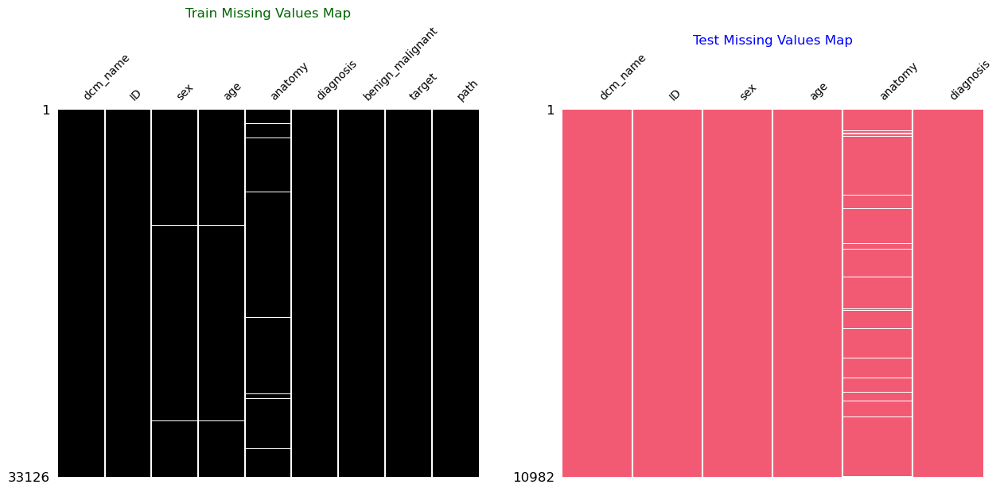

In [12]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (15, 6))

msno.matrix(train_df, ax = ax1, sparkline = False, color = (0,0,0), fontsize=10);
msno.matrix(test_df, ax = ax2, sparkline = False, color = (0.95,0.35,0.45), fontsize=10);

ax1.set_title('Train Missing Values Map', fontsize = 12, color = "#006400");
ax2.set_title('Test Missing Values Map', fontsize = 12, color = "#0000FF");

#### 4.3. Plotting Gender values

In [13]:
print(train_df['sex'].value_counts())
print("------------------------------------")
print("-----------------------------------")
print(test_df['sex'].value_counts())

male      17080
female    15981
Name: sex, dtype: int64
------------------------------------
-----------------------------------
male      6255
female    4727
Name: sex, dtype: int64


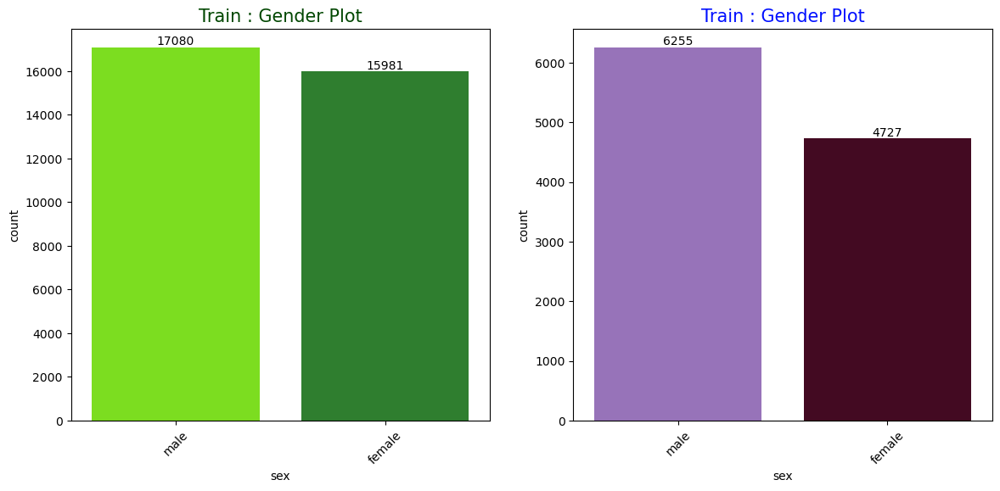

In [14]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (14, 6))

a = sns.countplot(data = train_df, x = 'sex', palette = ["#7CFC00", "#228B22"], ax = ax1);
a = sns.countplot(data = test_df, x = 'sex', palette = ["#9867c5", "#4c0121"], ax = ax2);

ax1.set_title("Train : Gender Plot",fontsize = 15,color="#004600")
ax2.set_title("Train : Gender Plot",fontsize = 15,color="#000FFF")

ax1.bar_label(ax1.containers[0])
ax2.bar_label(ax2.containers[0])

ax1.tick_params(axis = 'x', rotation = 45)
ax2.tick_params(axis = 'x', rotation = 45)

#### 4.3. Plotting Age values 

In [15]:
print(train_df['age'].describe())
print("-----------------------------------")
print("-----------------------------------")
print(test_df['age'].describe())

count    33058.000000
mean        48.870016
std         14.380360
min          0.000000
25%         40.000000
50%         50.000000
75%         60.000000
max         90.000000
Name: age, dtype: float64
-----------------------------------
-----------------------------------
count    10982.000000
mean        49.525587
std         14.370589
min         10.000000
25%         40.000000
50%         50.000000
75%         60.000000
max         90.000000
Name: age, dtype: float64


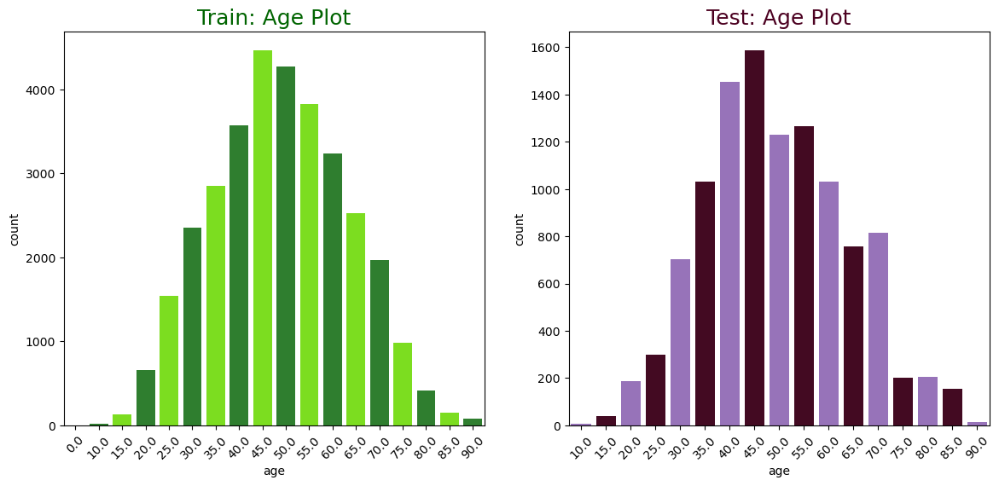

In [16]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (14, 6))

a = sns.countplot(data = train_df, x = 'age', palette = ["#7CFC00", "#228B22"], ax = ax1);
a = sns.countplot(data = test_df, x = 'age', palette = ["#9867c5", "#4c0121"], ax = ax2);

ax1.set_title('Train: Age Plot', fontsize = 18, color = "#006400");
ax2.set_title('Test: Age Plot', fontsize = 18, color = "#4c0121");

ax1.tick_params(axis = 'x', rotation = 45)
ax2.tick_params(axis = 'x', rotation = 45)

#### 4.4. Anatomy Plot

In [17]:
print(train_df["anatomy"].value_counts())

print("-----------------------------------")
print("-----------------------------------")

print(test_df["anatomy"].value_counts())

torso              16845
lower extremity     8417
upper extremity     4983
head/neck           1855
palms/soles          375
oral/genital         124
Name: anatomy, dtype: int64
-----------------------------------
-----------------------------------
torso              5847
lower extremity    2501
upper extremity    1573
head/neck           576
palms/soles         108
oral/genital         26
Name: anatomy, dtype: int64


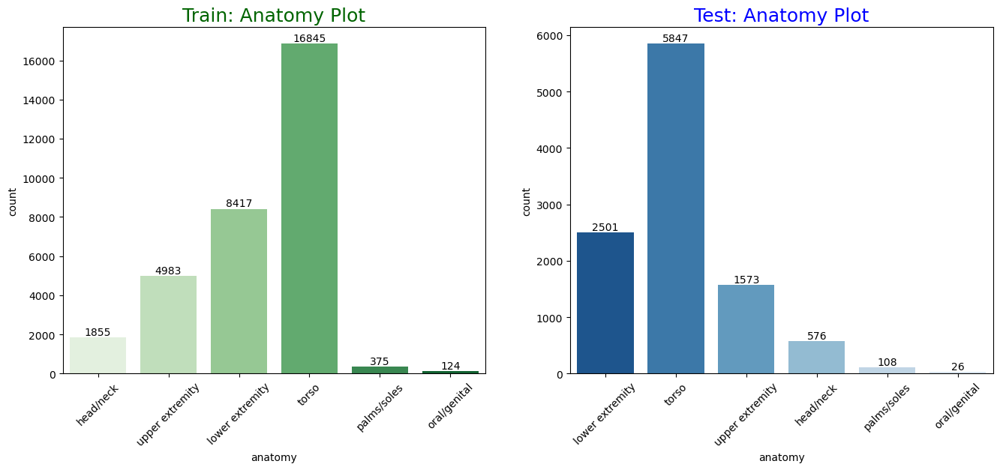

In [18]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (16, 6))

a = sns.countplot(data = train_df, x = 'anatomy', palette = "Greens", ax = ax1);
a = sns.countplot(data = test_df, x = 'anatomy', palette = "Blues_r", ax = ax2);

ax1.set_title('Train: Anatomy Plot', fontsize = 18, color = "#006400");
ax2.set_title('Test: Anatomy Plot', fontsize = 18, color = "#0000FF");

ax1.bar_label(ax1.containers[0]);
ax2.bar_label(ax2.containers[0]);

ax1.tick_params(axis = 'x', rotation = 45)
ax2.tick_params(axis = 'x', rotation = 45)

#### 4.5. Target Feature Plot

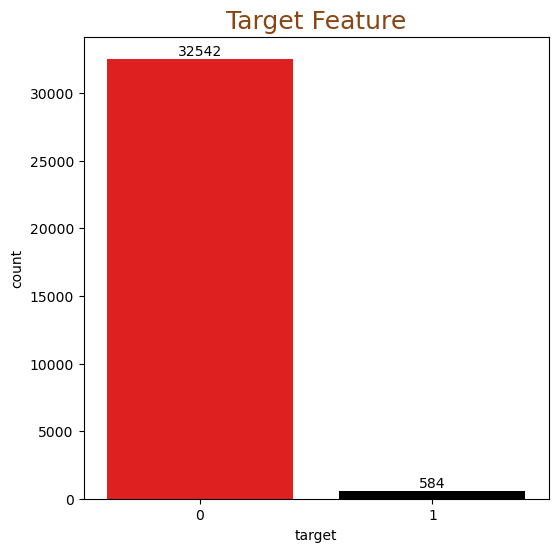

In [19]:
plt.figure(figsize = (6,6))


a = sns.countplot(data = train_df, x = 'target', palette = ['#F000', '#000F'])
a.bar_label(a.containers[0])
a.set_title('Target Feature', fontsize = 18, color = "#8B4513")

plt.show()

* Target Attributes :
    - Thus `malignant` are very less as compared to that of `benign`

In [20]:
train_parallel = train_df[['dcm_name', 'ID', 'sex', 'age', 'anatomy', 'diagnosis', 'target']]

fig = px.parallel_categories(train_parallel, color="target", color_continuous_scale = px.colors.sequential.algae)
fig.update_layout(title = 'Parallel Category Diagram')
fig.show()

- There are `patients with multiple images taken`, in BOTH Train and Test datasets.

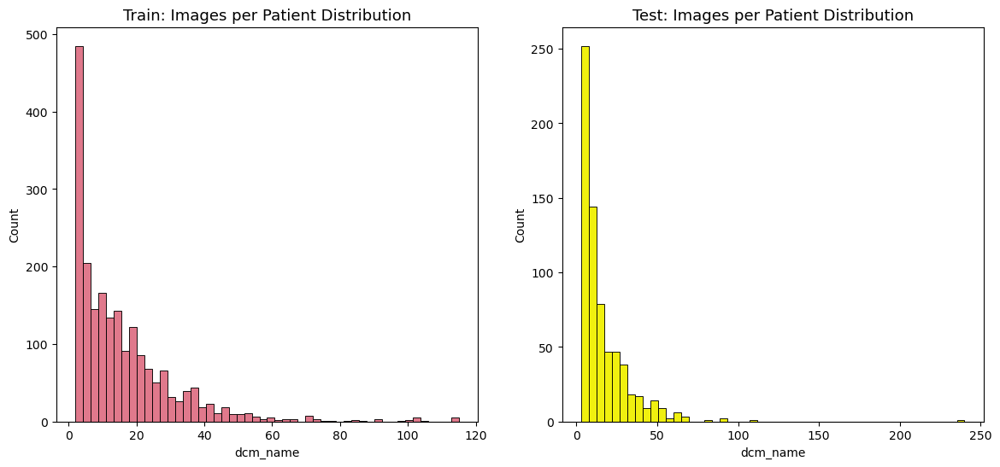

In [21]:
pat_train = train_df.groupby(by='ID')['dcm_name'].count().reset_index()
pat_test = test_df.groupby(by='ID')['dcm_name'].count().reset_index()

# Figure
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Histogram for train DataFrame
a = sns.histplot(data=pat_train, x='dcm_name', kde=False, bins=50,
                 ax=ax1, color="#e0798c", alpha=1)

# Histogram for test DataFrame
b = sns.histplot(data=pat_test, x='dcm_name', kde=False, bins=50,
                 ax=ax2, color="#F0F00F", alpha=1)

# Set titles for the plots
ax1.set_title('Train: Images per Patient Distribution', fontsize=13)
ax2.set_title('Test: Images per Patient Distribution', fontsize=13)

# Display the plot
plt.show()

#### 4.6. Exploring the Images

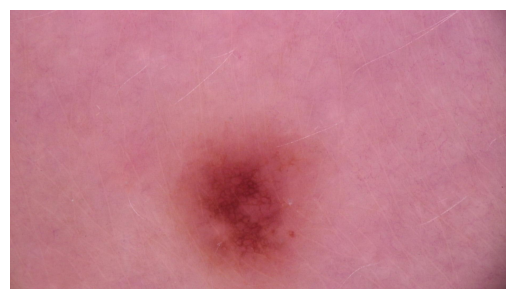

In [22]:
plt.figure()
image = cv2.imread("../input/siim-isic-melanoma-classification/jpeg/train/ISIC_0076995.jpg")[...,::-1]
plt.imshow(image)
plt.axis('off')
plt.show() 

##### 4.6.1. Image Properties

In [23]:
print('Image Shape: {}'.format(image.shape))
print('Image Height: {}'.format(image.shape[0]))
print('Image Width: {}'.format(image.shape[1]))
print('Image Dimension: {}'.format(image.ndim))
print('Image Size: {}kb'.format(image.size//1024))
print('Image Data Type: {}'.format(image.dtype))
print('Maximum RGB value of the image: {}'.format(image.max()))
print('Minimum RGB value of the image: {}'.format(image.min()))


Image Shape: (1053, 1872, 3)
Image Height: 1053
Image Width: 1872
Image Dimension: 3
Image Size: 5775kb
Image Data Type: uint8
Maximum RGB value of the image: 245
Minimum RGB value of the image: 21


##### 4.6.2. Blue Channel

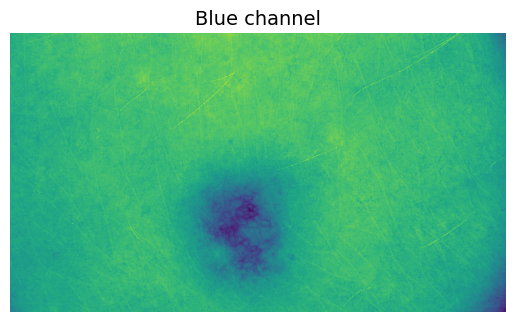

In [24]:
plt.title('Blue channel', fontsize = 14)
plt.imshow(image[ : , : , 0])
plt.axis('off');
plt.show()


##### 4.6.3. Plotting some random original images before Augmentation

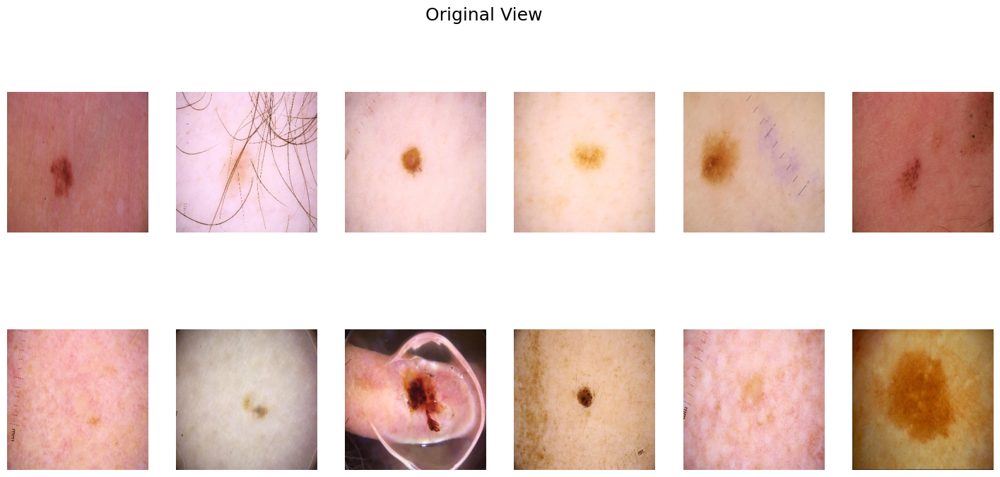

In [25]:
image_list = train_df.sample(12)['path']
image_list = image_list.reset_index()['path']

plt.figure(figsize = (18, 8))
plt.suptitle("Original View", fontsize = 18)
    
for k, path in enumerate(image_list):
    image = cv2.imread(path)[...,::-1]
    image = cv2.resize(image,(300, 300))
    plt.subplot(2, 6, k+1)
    plt.imshow(image)
    plt.axis('off')

##### 4.6.4. Plotting `Original`  `Benign Vs Malignant Images` 

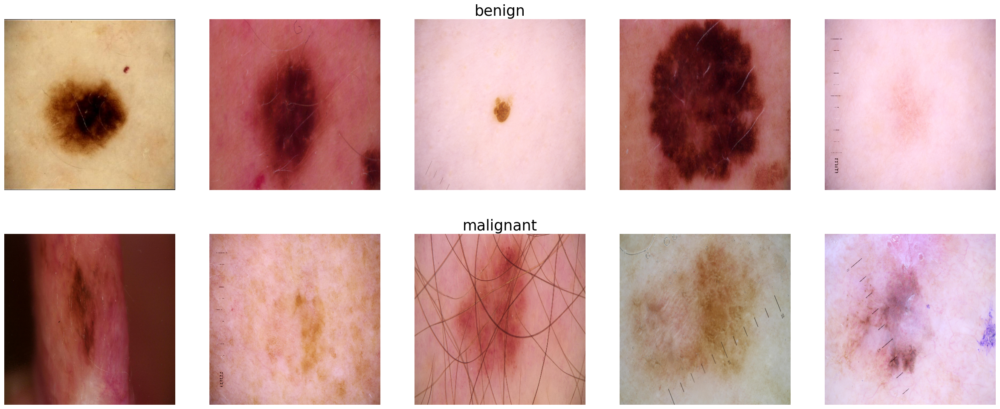

In [26]:
n_samples = 5
fig, m_axs = plt.subplots(2, n_samples, figsize = (6*n_samples, 3*4))

for n_axs, (type_name, type_rows) in zip(m_axs, train_df.sort_values(['benign_malignant']).groupby('benign_malignant')):
    n_axs[2].set_title(type_name, fontsize = 25)
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state = 1234).iterrows()):       
        picture = c_row['path']
        image = cv2.imread(picture)[...,::-1]
        image = cv2.resize(image, (400, 400))
        c_ax.imshow(image)
        c_ax.axis('off')

##### 4.6.5. Checking Intensity of Channel

Image dimensions:  (4000, 6000)
Maximum pixel value : 255.0 ; Minimum pixel value:0.0
Mean value of the pixels : 171.1 ; Standard deviation : 42.0


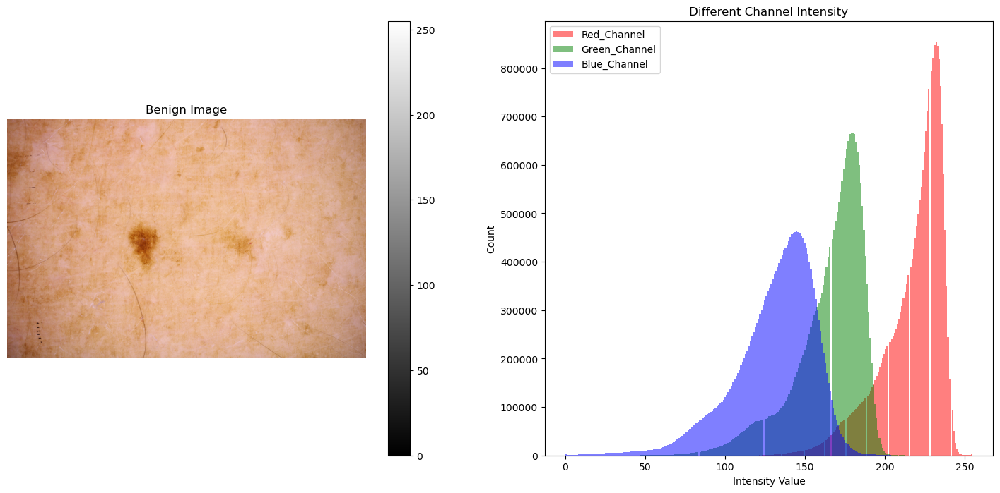

In [27]:
f = plt.figure(figsize = (18, 8))

f.add_subplot(1,2,1)

sample_img = "ISIC_0015719.jpg"
raw_image = plt.imread(os.path.join(train_path, sample_img))
plt.imshow(raw_image, cmap='gray')
plt.axis('off')
plt.colorbar()
plt.title('Benign Image')
print(f"Image dimensions:  {raw_image.shape[0],raw_image.shape[1]}")
print(f"Maximum pixel value : {raw_image.max():.1f} ; Minimum pixel value:{raw_image.min():.1f}")
print(f"Mean value of the pixels : {raw_image.mean():.1f} ; Standard deviation : {raw_image.std():.1f}")

f.add_subplot(1,2,2)

plt.hist(raw_image[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
plt.hist(raw_image[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
plt.hist(raw_image[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)
plt.xlabel('Intensity Value')
plt.ylabel('Count')
plt.legend(['Red_Channel', 'Green_Channel', 'Blue_Channel'])
plt.title('Different Channel Intensity')
plt.show()

##### 4.6.6. `Benign` vs `Malignant` Augmentations on image

In [28]:
def plot_multiple_img(img_matrix_list, title_list, ncols, main_title):
    
    fig, myaxes = plt.subplots(figsize = (18, 12), nrows = 3, ncols = ncols, squeeze = False)
    fig.suptitle(main_title, fontsize = 18)
    fig.subplots_adjust(wspace = 0.3)
    fig.subplots_adjust(hspace = 0.3)
    
    for i, (img, title) in enumerate(zip(img_matrix_list, title_list)):
        myaxes[i // ncols][i % ncols].imshow(img)
        myaxes[i // ncols][i % ncols].set_title(title, fontsize = 13)
    
    plt.show()

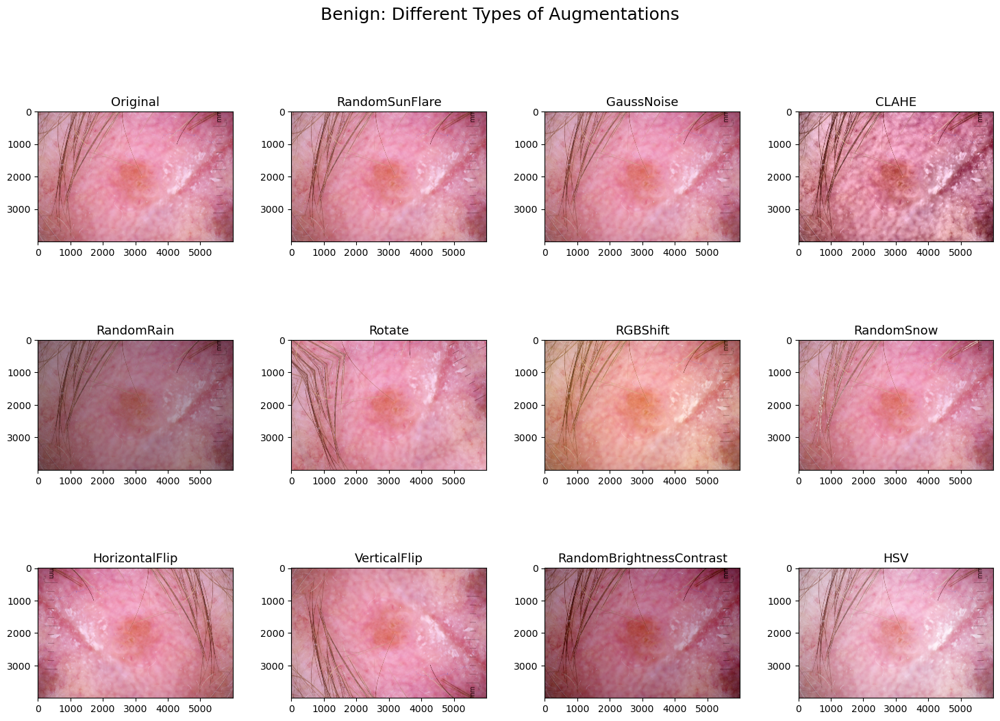

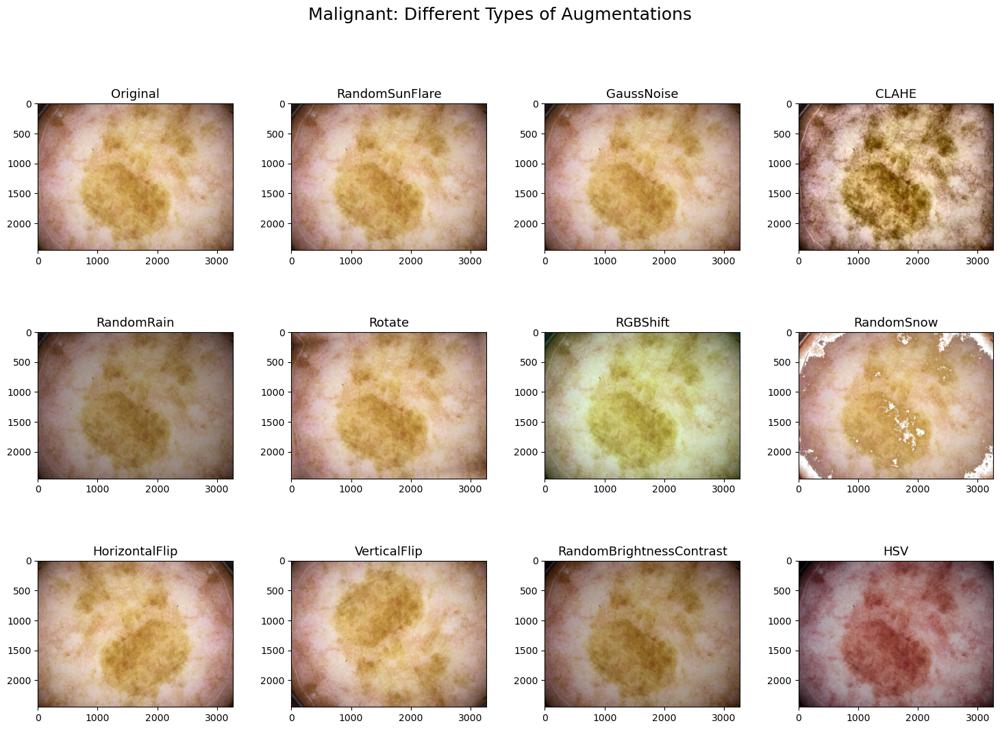

In [29]:
malignant_image = cv2.imread("../input/siim-isic-melanoma-classification/jpeg/train/ISIC_0188432.jpg")[...,::-1]
benign_image = cv2.imread("../input/siim-isic-melanoma-classification/jpeg/train/ISIC_2637011.jpg")[...,::-1]

albumentation_list = [A.RandomSunFlare(p=0.8), A.GaussNoise(p=0.8), A.CLAHE(p=0.9),
                      A.RandomRain(p=1), A.Rotate(p=1, limit=90),
                      A.RGBShift(p=1), A.RandomSnow(p=1),
                      A.HorizontalFlip(p=1), A.VerticalFlip(p=0.8), A.RandomBrightnessContrast(p = 1),
                      A.HueSaturationValue(p=1,hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=50)]

chosen_image = [benign_image, malignant_image]
l = ["Benign: Different Types of Augmentations", "Malignant: Different Types of Augmentations\n"]

for i in range(2):
    img_matrix_list = []
    bboxes_list = []
    for aug_type in albumentation_list:
        img = aug_type(image = chosen_image[i])['image']
        img_matrix_list.append(img)
    img_matrix_list.insert(0, chosen_image[i])    
    titles_list = ["Original","RandomSunFlare","GaussNoise","CLAHE","RandomRain","Rotate", 
                   "RGBShift", "RandomSnow","HorizontalFlip", "VerticalFlip", "RandomBrightnessContrast","HSV"]
    plot_multiple_img(img_matrix_list, titles_list, ncols = 4, main_title = l[i])

##### 4.6.7. Hue, Saturation, Brigtness

In [30]:
def plotting_hue_saturation_brightness(text, df):

    fig, axes = plt.subplots(nrows = 2, ncols = 6, figsize = (18, 6))
    plt.suptitle(text, fontsize = 16)

    for i in range(0, 2*6):
        image = cv2.imread(df['path'][i])[...,::-1]
        image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        image = cv2.resize(image, (200,200))
        x = i // 6
        y = i % 6
        axes[x, y].imshow(image, cmap=plt.cm.bone) 
        axes[x, y].axis('off')

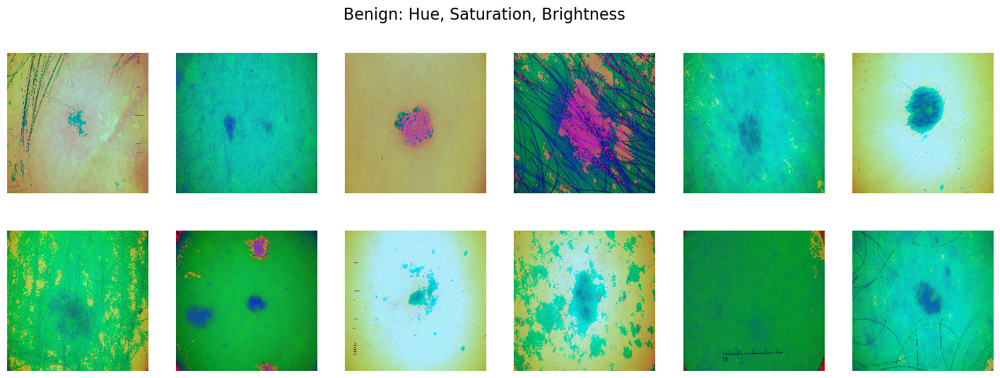

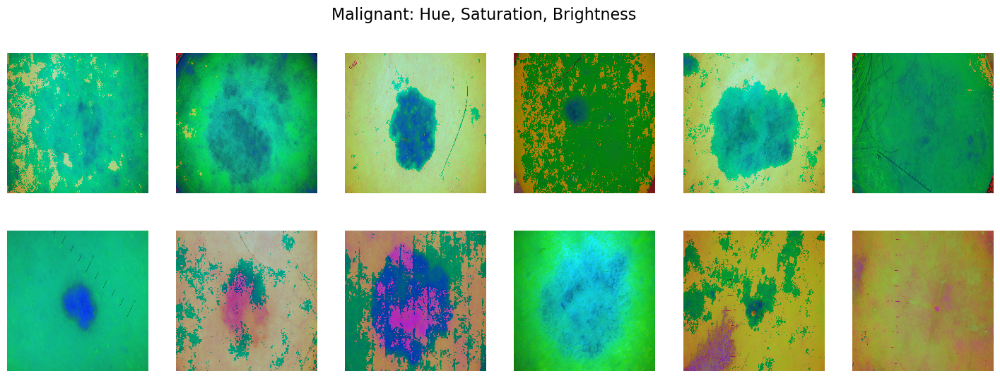

In [31]:
plotting_hue_saturation_brightness("Benign: Hue, Saturation, Brightness", benign_data)
plotting_hue_saturation_brightness("Malignant: Hue, Saturation, Brightness", malignant_data)

##### 4.6.8. Gaussian Blur:

In [32]:
def plot_gaussian_blurr(text, df):

    fig, axes = plt.subplots(nrows = 2, ncols = 6, figsize = (18, 6))
    plt.suptitle(text, fontsize = 16)

    for i in range(0, 12):
        image = cv2.imread(df['path'][i])[...,::-1]
        image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        image = cv2.resize(image, (200,200))
        image=cv2.addWeighted(image, 4, cv2.GaussianBlur(image, (0,0) ,256/10), -4, 128)
        x = i // 6
        y = i % 6
        axes[x, y].imshow(image, cmap=plt.cm.bone) 
        axes[x, y].axis('off')

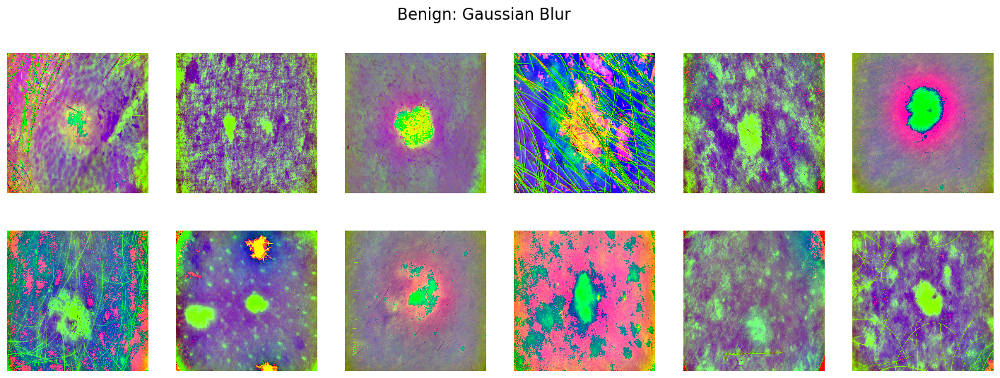

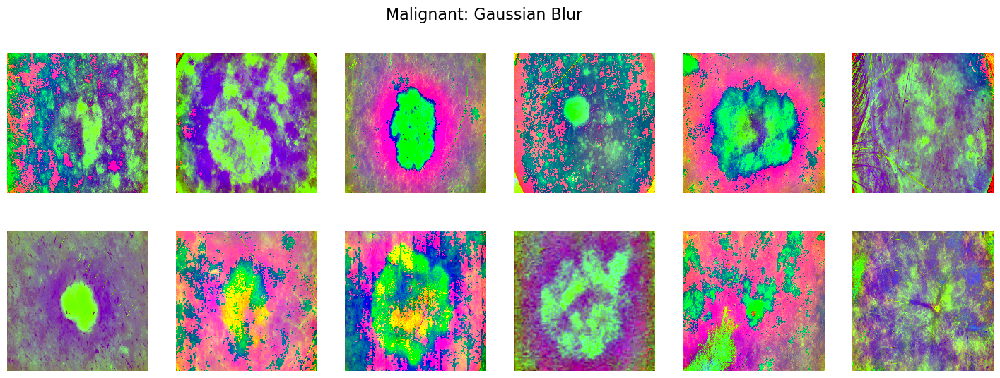

In [33]:
plot_gaussian_blurr("Benign: Gaussian Blur", benign_data)
print()
plot_gaussian_blurr("Malignant: Gaussian Blur", malignant_data)

##### 4.6.9. Black and White Scale Augmentation

In [34]:
def plot_black_white(text, df):
    fig, axes = plt.subplots(nrows = 2, ncols = 6, figsize = (18, 6))
    plt.suptitle(text, fontsize = 16)
    for i in range(0, 2*6):
        image = cv2.imread(df['path'][i])[...,::-1]
        image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        image = cv2.resize(image, (200,200))
        x = i // 6
        y = i % 6
        axes[x, y].imshow(image, cmap=plt.cm.bone) 
        axes[x, y].axis('off')


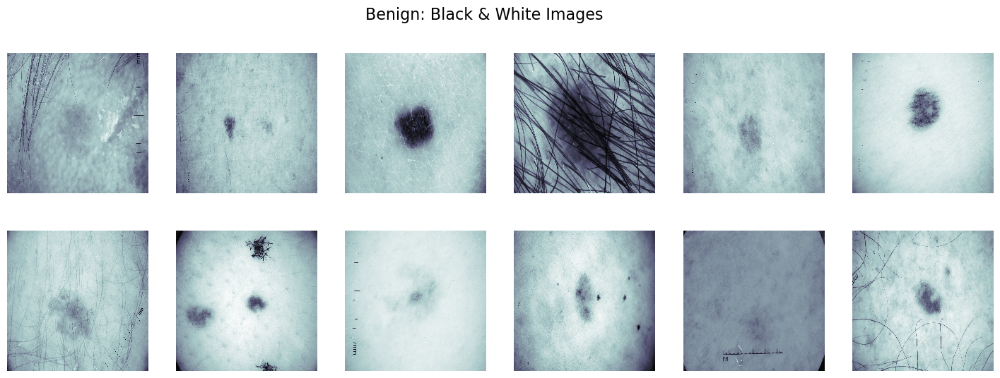

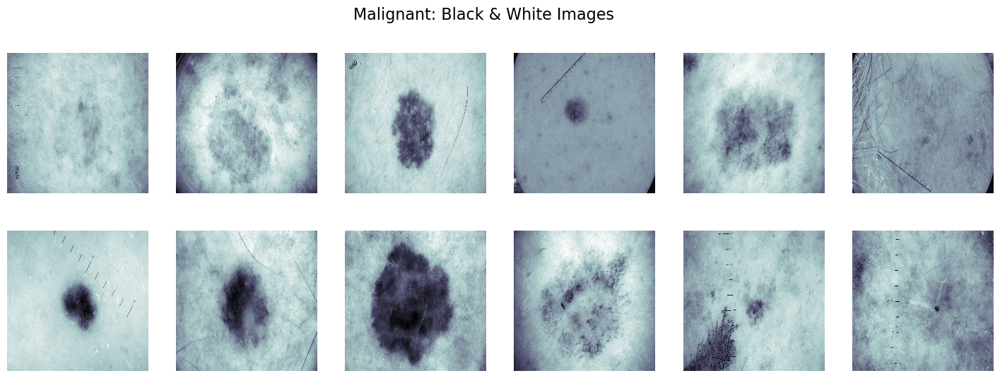

In [35]:
plot_black_white("Benign: Black & White Images", benign_data)
print()
plot_black_white("Malignant: Black & White Images", malignant_data)

##### 4.6.10. Cancer problems related to skin during different age 

In [36]:
def grid_display(list_of_images, no_of_columns, figsize, title):
    fig = plt.figure(figsize=figsize)
    column = 0
    z = 0
    for i in range(len(list_of_images)):
        column += 1
        
        if column == no_of_columns + 1:
            fig = plt.figure(figsize=figsize)
            column = 1
        fig.add_subplot(1, no_of_columns, column)
        
        if title:
            if i >= no_of_columns:
                plt.title(titles[z])
                z += 1
            else:
                plt.title(titles[i])
                
        list_of_images[i] = cv2.resize(list_of_images[i], (300, 200))
        plt.imshow(list_of_images[i])
        plt.axis('off')

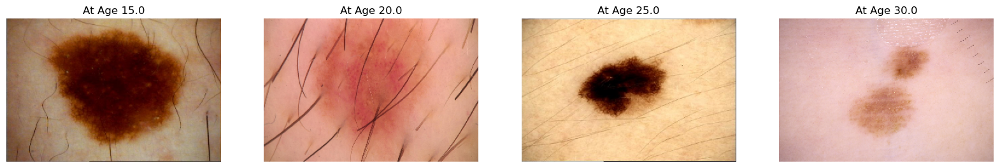

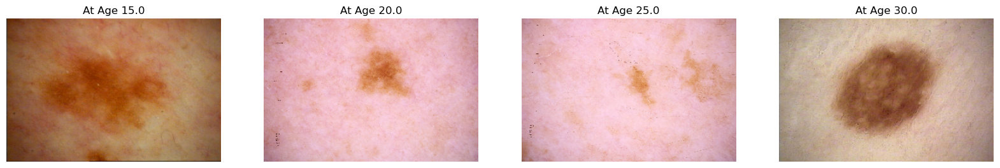

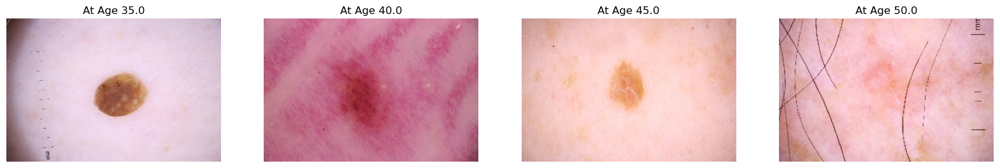

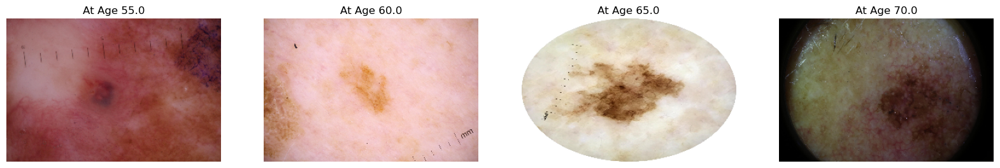

In [37]:
arr = [15.0,20.0,25.0,30.0,35.0,40.0,45.0,50.0,55.0,60.0,65.0,70.0,75.0,80.0,85.0,90.0]
image_all=[]
titles = ['At Age 15.0','At Age 20.0','At Age 25.0','At Age 30.0','At Age 35.0','At Age 40.0'
          ,'At Age 45.0','At Age 50.0','At Age 55.0','At Age 60.0','At Age 65.0','At Age 70.0'
          ,'At Age 75.0','At Age 80.0','At Age 85.0','At Age 90.0']

for i in arr:
    image_list = train_df[train_df['age'] == i].sample()['dcm_name']
    for image_id in image_list:
        image_file = f'/kaggle/input/siim-isic-melanoma-classification/jpeg/train/'+image_id
        img = np.array(Image.open(image_file))
        image_all.append(img)
        
grid_display(image_all, 4, (20, 15), title = True)

##### 4.6.11. Cropping

In [38]:
def plot_cropping(df, flag):
    if flag == 1:
        img = cv2.imread(df['path'][2])[...,::-1]
    else:
        img = cv2.imread(df['path'][1])[...,::-1]
    
    image_all = []
    titles = ['original', 'Detect Affected Part', "Cropped Image"]
    
    image_all.append(img)

    orb = cv2.ORB_create() # Initiate Detecting Affected Part
    kp = orb.detect(img, None) # find the keypoints with Detecting
    kp, des = orb.compute(img, kp) # compute the descriptors with Detecting

    img2 = cv2.drawKeypoints(img, kp, None, color = (0,255,0), flags = 0) # draw only keypoints location, not size and orientation
    image_all.append(img2)
    img3 = img2[350:800,600:1250]
    image_all.append(img3)

    grid_display(image_all, 3, (20, 15), title = False)

Benign: Cropping Analysis


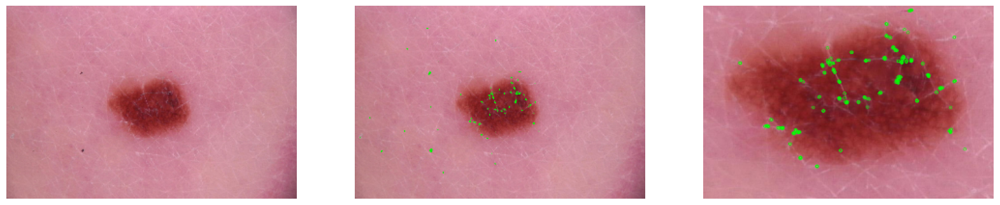

In [39]:
print("Benign: Cropping Analysis")
plot_cropping(benign_data, 1)


Malignant: Cropping Analysis


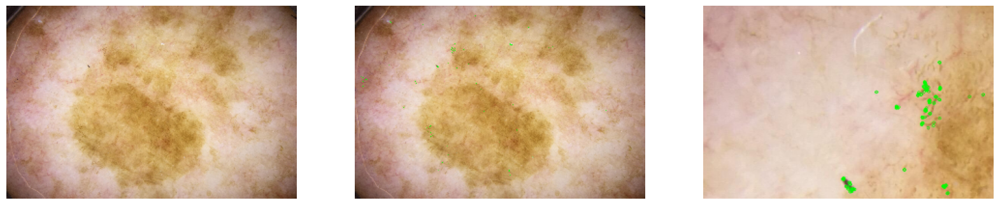

In [40]:
print("Malignant: Cropping Analysis")
plot_cropping(malignant_data, 0)

##### 4.6.12. Display Different Anatomy that affects on Malanoma

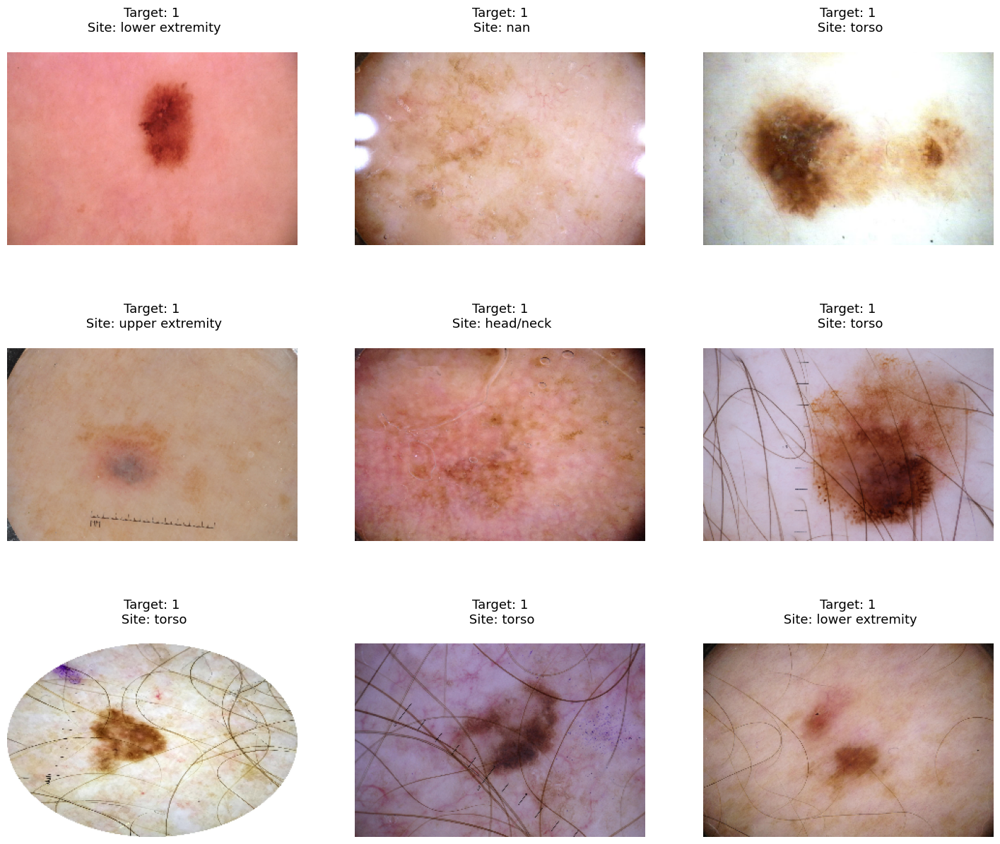

In [41]:
def display_image(df):
    
    random_sampling = [random.randint(0, len(df)) for i in range(9)]
    image_indexes = [list(df.index)[random_sampling[i]] for i in range(len(random_sampling))]
    i = 0
    plt.figure(figsize = (18, 12))
    
    for index in image_indexes:
        image_name = df.loc[index, 'dcm_name'] 
        site = df.loc[index, "anatomy"]
        target = df.loc[index, "target"]        
        plt.subplot(330 + 1 + i) 
        plt.title('Target: {}\n Site: {}\n'.format(target, site), fontsize = 13)
        numpy_image = cv2.imread(train_path +"/"+ image_name)
        numpy_image = cv2.resize(numpy_image, (300, 200))
        plt.imshow(cv2.cvtColor(numpy_image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        i+=1
        
    plt.subplots_adjust(bottom = 0.001)  
    plt.subplots_adjust(top = 0.99)
    plt.show()
display_image(malignant_data)

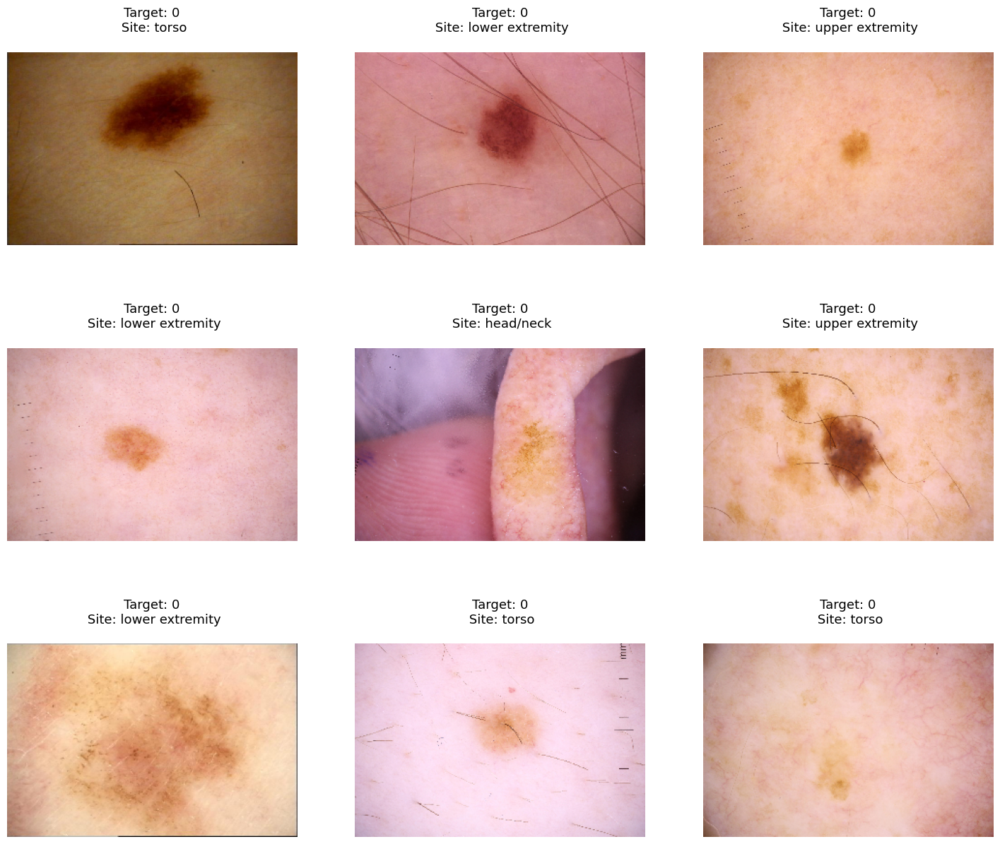

In [42]:
display_image(benign_data)


##### 4.6.13. Process of Hair Removal

In [43]:
def hair_remove(image):
    
    grayScale = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY) # convert image to grayScale
    kernel = cv2.getStructuringElement(1,(17,17)) # kernel for morphologyEx
    blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel) # apply MORPH_BLACKHAT to grayScale image
    _,threshold = cv2.threshold(blackhat,10,255,cv2.THRESH_BINARY) # apply thresholding to blackhat
    final_image = cv2.inpaint(image,threshold,1,cv2.INPAINT_TELEA) # inpaint with original image and threshold image
    
    return final_image

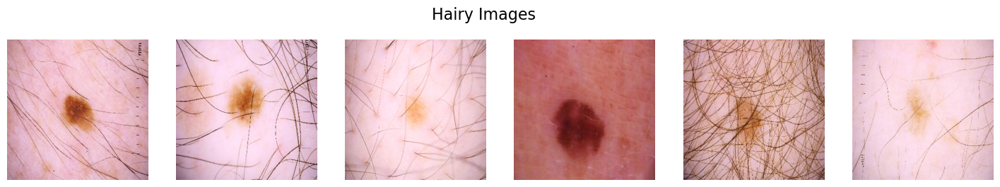

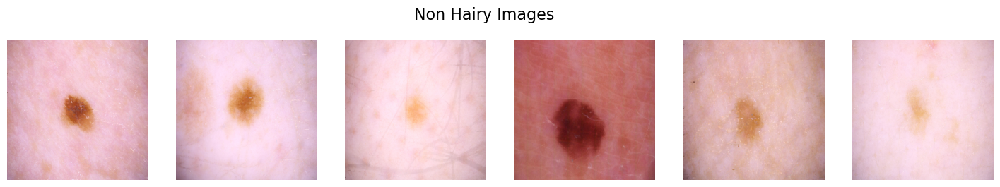

In [44]:
def plot_hair_images(text, flag):

    hairy_photos = train_df[train_df["sex"] == "male"].reset_index().iloc[[12, 14, 17, 22, 33, 34]]
    image_list = hairy_photos['path']
    image_list = image_list.reset_index()['path']
    
    plt.figure(figsize = (18, 3))
    plt.suptitle(text, fontsize = 16)

    for k, path in enumerate(image_list):
        image = cv2.imread(path)[...,::-1]
        image = cv2.resize(image,(300, 300))
        if flag == 1:
            image = hair_remove(image)
            plt.subplot(1, 6, k+1)
            plt.imshow(image)
            plt.axis('off')
        else:
            plt.subplot(1, 6, k+1)
            plt.imshow(image)
            plt.axis('off')

plot_hair_images("Hairy Images", 0)    
plot_hair_images("Non Hairy Images", 1)  

##### 4.6.14. Color Jitter using PyTorch

In [45]:
image_list = train_df.sample(12)['path']
image_list = image_list.reset_index()['path']

In [46]:
class DatasetExample(Dataset):
    def __init__(self, image_list, transforms=None):
        self.image_list = image_list
        self.transforms = transforms
    
    def __len__(self):
        return (len(self.image_list))
    
    def __getitem__(self, i):
        image = plt.imread(self.image_list[i])
        image = Image.fromarray(image).convert('RGB')        
        image = np.asarray(image).astype(np.uint8)
        if self.transforms is not None:
            image = self.transforms(image)
            
        return torch.tensor(image, dtype=torch.float)

In [47]:
def show_transform(image, title="Default"):
    plt.figure(figsize = (18, 12))
    plt.suptitle(title, fontsize = 16)

    image = image / 2 + 0.5  
    npimg = image.numpy()
    npimg = np.clip(npimg, 0., 1.)
    
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()


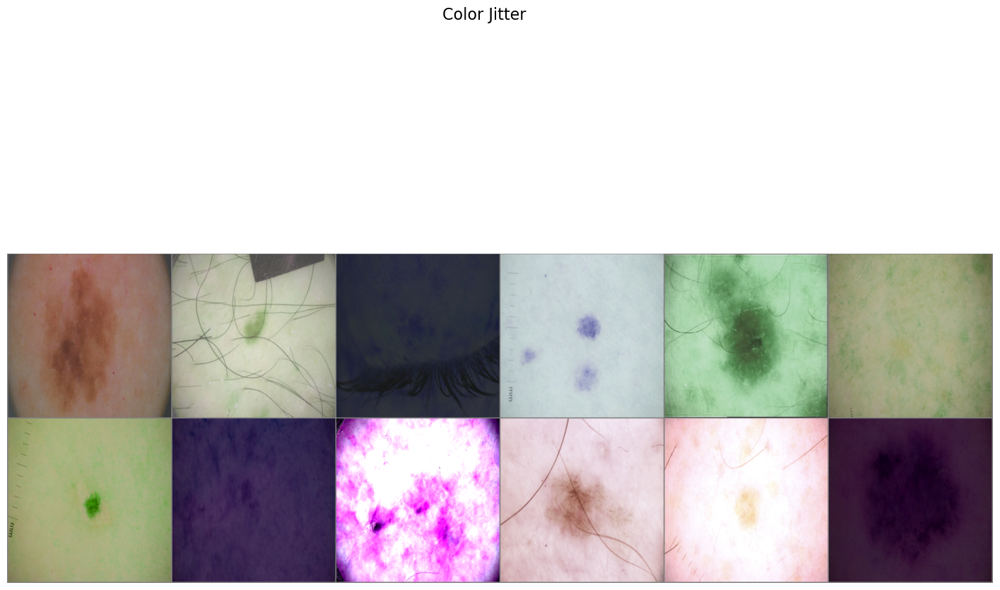

In [48]:
transform = transforms.Compose([
     transforms.ToPILImage(),
     transforms.Resize((300, 300)),
     transforms.ColorJitter(brightness=0.7, contrast=0.7, saturation=0.7, hue=0.5),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
     ])

pytorch_dataset = DatasetExample(image_list=image_list, transforms=transform)
pytorch_dataloader = DataLoader(dataset=pytorch_dataset, batch_size=12, shuffle=True)
images = next(iter(pytorch_dataloader))
 
show_transform(torchvision.utils.make_grid(images, nrow=6), title="Color Jitter")

In [49]:
output_folder = '/kaggle/working/folder'
os.makedirs(output_folder, exist_ok=True)


In [50]:
malignant_images = malignant_data['path'].tolist()

# Define the number of malignant samples to generate
num_malignant_samples = 100

for i in range(num_malignant_samples):
    image_path = random.choice(malignant_images)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Define the augmentation pipeline
    aug = A.Compose([
        A.HorizontalFlip(p=0.5),
        A.Rotate(limit=30, p=0.5),
        A.RandomResizedCrop(height=300, width=300, scale=(0.8, 1.0), p=0.5),
        A.GaussianBlur(blur_limit=(3, 7), p=0.3),
        A.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=30, p=0.5),
        # Add more augmentations as needed
    ])

    # Apply the augmentations to the image
    augmented_image = aug(image=image)['image']

    # Save the augmented image
    image_name = f'malignant_augmented_{i}.jpg'
    output_path = os.path.join(output_folder, image_name)
    cv2.imwrite(output_path, augmented_image)


In [51]:
import shutil
def func(data,count,namee):
    # Assuming you have a list of paths for benign images
    data_images = data['path'].tolist()

    # Specify the output folder to store the additional benign images
    output_folder = '/kaggle/working/folder'

    # Define the number of samples to generate for the benign class
    num_benign_samples = count

    # Create the output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Function to copy and rename the images to the output folder
    def copy_and_rename_image(image_path, output_folder, category, image_number):
        image_name = f"{category}_{image_number}.jpg"
        output_path = os.path.join(output_folder, image_name)
        shutil.copy(image_path, output_path)

    # Generate additional benign samples and rename them
    for i in range(num_benign_samples):
        image_path = random.choice(data_images)
        copy_and_rename_image(image_path, output_folder, namee, i + 1)

    print(f"{num_benign_samples} {namee} images added to the output folder.")

In [52]:
func(benign_data,300,"benign")

300 benign images added to the output folder.


In [53]:
func(malignant_data,100,"malignant")

100 malignant images added to the output folder.


**References**:

1. [Missingno](https://towardsdatascience.com/using-the-missingno-python-library-to-identify-and-visualise-missing-data-prior-to-machine-learning-34c8c5b5f009)

2. [Parallel Category Diagram](https://plotly.com/python/parallel-categories-diagram/)